# CA3 - Anniken Rabben

Kaggleusername: Anniken01


### Imports

In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from scipy import stats

/var/folders/qf/9lcflp0s1nq8l85_tw03dz180000gp/T/ipykernel_45459/2252469097.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


### Reading data

In [2]:
raw_test = pd.read_csv('test.csv')
raw_train = pd.read_csv('train.csv')

In [3]:
raw_train.head() # view first 5 lines

,Unnamed: 0,Acoustic Firmness Index,Atmospheric Pressure at Harvest (Pa),Bitterness Scale,Circumference (mm),Color Intensity (a.u.),Find Distance from Main Vulcano (km),Length (mm),Luminescence Intensity (a.u.),Magnetic orientation (degree),Odor index (a.u.),Seed Count,Skin Thickness (mm),Soil pH where Grown,Sugar Content (mg),Weight (mg),pH,Edible
0,0,28.7,98741.0,0.0,222.897985,70.28,103.145212,35.481123,0.002636,61.877407,2.700236,71.355713,2.5,8.14,13792.0,87411.1826,5.090000,1.0
1,1,19.4,96077.0,0.0,205.832386,66.48,102.005624,32.609013,0.015950,297.191998,9.618586,46.291493,2.0,7.63,12985.0,72608.1826,4.990000,1.0
2,2,22.1,109154.0,2.0,234.406576,69.92,37.847317,37.926057,0.000279,61.103057,7.970050,54.442385,1.5,8.03,10008.0,109375.1826,5.219156,0.0
3,3,28.0,105277.0,5.0,214.999623,64.05,100.118399,34.610539,0.002323,58.677047,68.116450,106.401880,4.5,7.43,11303.0,84958.7826,3.228828,0.0
4,4,22.6,103898.0,2.0,180.542626,53.63,63.590438,28.948902,0.008611,317.261190,7.953544,48.057754,5.0,6.71,11475.0,49717.1826,4.800000,1.0


### Data exploration and visualisation

In [4]:
print(raw_train.isnull().sum()) # view missing data


Unnamed: 0                              0
Acoustic Firmness Index                 3
Atmospheric Pressure at Harvest (Pa)    0
Bitterness Scale                        4
Circumference (mm)                      2
Color Intensity (a.u.)                  0
Find Distance from Main Vulcano (km)    2
Length (mm)                             4
Luminescence Intensity (a.u.)           1
Magnetic orientation (degree)           3
Odor index (a.u.)                       2
Seed Count                              1
Skin Thickness (mm)                     1
Soil pH where Grown                     3
Sugar Content (mg)                      3
Weight (mg)                             4
pH                                      4
Edible                                  0
dtype: int64


In [5]:
train = raw_train.dropna() # remove NaN values 
print(train.isnull().sum())# view if there is still missing data after removing NaN values

Unnamed: 0                              0
Acoustic Firmness Index                 0
Atmospheric Pressure at Harvest (Pa)    0
Bitterness Scale                        0
Circumference (mm)                      0
Color Intensity (a.u.)                  0
Find Distance from Main Vulcano (km)    0
Length (mm)                             0
Luminescence Intensity (a.u.)           0
Magnetic orientation (degree)           0
Odor index (a.u.)                       0
Seed Count                              0
Skin Thickness (mm)                     0
Soil pH where Grown                     0
Sugar Content (mg)                      0
Weight (mg)                             0
pH                                      0
Edible                                  0
dtype: int64


In [6]:
train = train.iloc[:,1:] # create new train df without the first column
test = raw_test.iloc[:,1:]# create new test df without the first column
train.shape

(1211, 17)

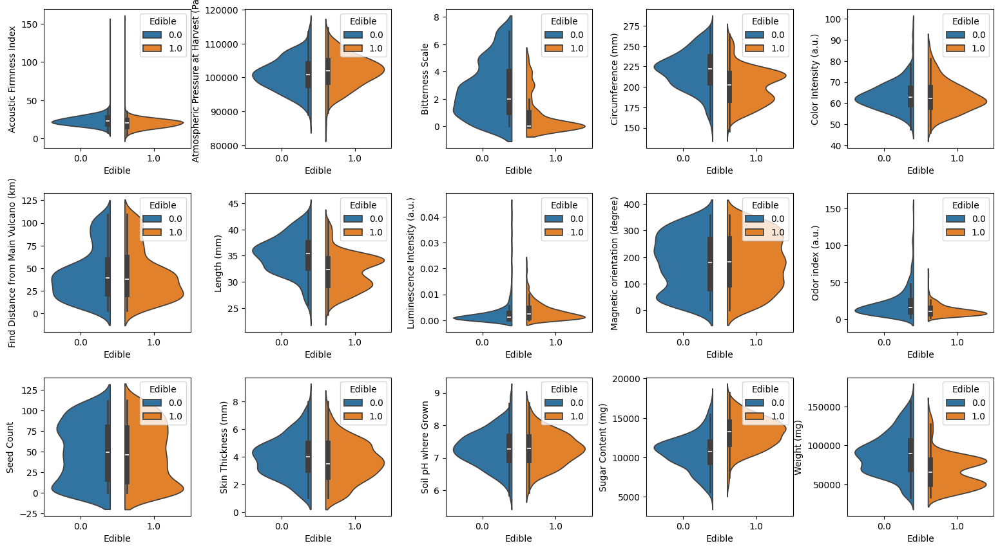

In [7]:
# violin plot
fig_violin, ax_violin = plt.subplots(nrows=3, ncols=5, figsize=(16, 9))
plt.tight_layout(pad=3.0)

i = 0
for row in range(3):
    for col in range(5):
        sns.violinplot(ax=ax_violin[row, col], data=train, x='Edible', y=train.columns[i], 
                       hue='Edible', split=True) # the split makes it easier to see the differenvce for edible 1 or 0
        i += 1
        
plt.show()

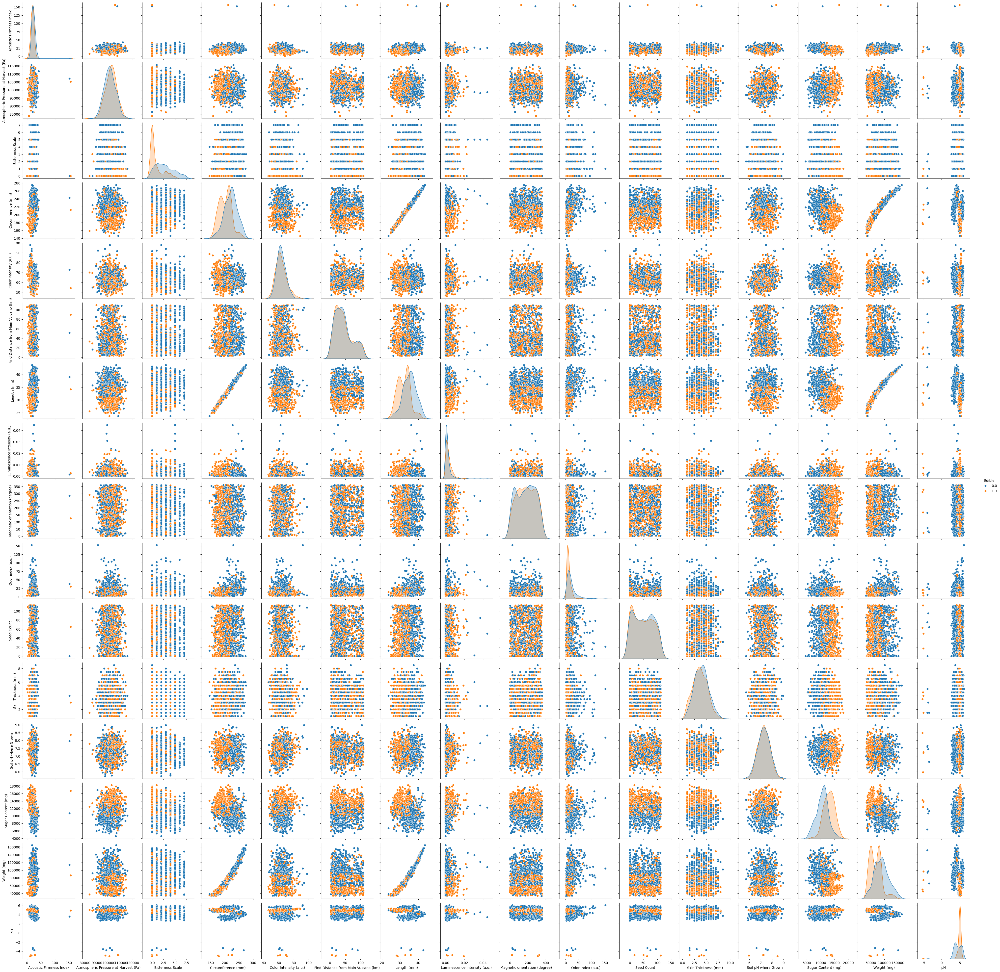

In [8]:
# Pairplot to get an overview of the data
sns.pairplot(data=train, hue = 'Edible')
plt.show()

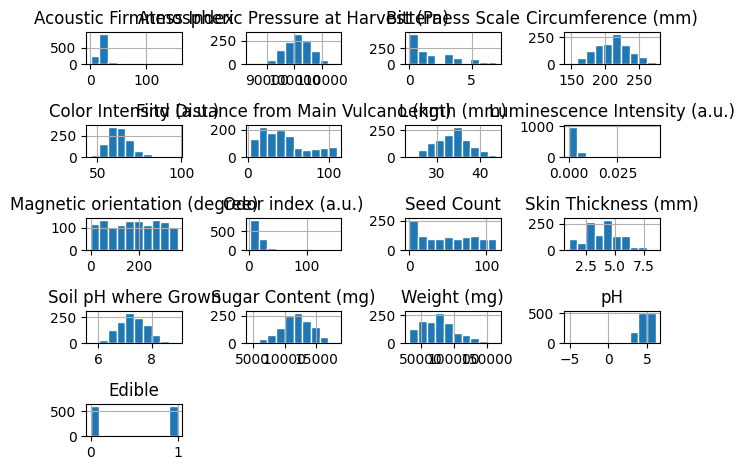

In [9]:
# Histogram 
train.hist(edgecolor="white") # edgecolor makes it look nicer 
plt.tight_layout()
plt.show()

In [10]:
train.describe()

,Acoustic Firmness Index,Atmospheric Pressure at Harvest (Pa),Bitterness Scale,Circumference (mm),Color Intensity (a.u.),Find Distance from Main Vulcano (km),Length (mm),Luminescence Intensity (a.u.),Magnetic orientation (degree),Odor index (a.u.),Seed Count,Skin Thickness (mm),Soil pH where Grown,Sugar Content (mg),Weight (mg),pH,Edible
count,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000,1211.000000
mean,21.621178,101334.720066,1.806771,210.987717,63.265813,44.075151,33.587497,0.002807,179.297447,16.615868,48.891065,3.840628,7.275557,11828.332783,78497.846382,4.615012,0.495458
std,8.181122,4794.219412,1.967669,24.663608,7.084117,28.350536,3.872755,0.003544,102.340098,14.903585,35.784413,1.478983,0.529511,2422.043017,26714.531928,1.002181,0.500186
min,0.600000,83825.000000,0.000000,145.867667,46.060000,2.550790,23.672207,0.000004,0.085357,1.722825,0.000000,1.000000,5.710000,4566.000000,32352.182600,-5.120000,0.000000
25%,17.300000,98066.500000,0.000000,192.929296,58.575000,21.042993,30.773093,0.000625,90.659112,7.639059,16.026009,3.000000,6.910000,10350.000000,57079.182600,4.175145,0.000000
50%,21.400000,101361.000000,1.000000,212.109985,62.380000,38.393334,33.753213,0.001751,180.716345,12.293670,47.932723,4.000000,7.280000,11791.000000,77447.182600,4.910000,0.000000
75%,25.400000,104509.500000,3.000000,226.427363,67.205000,60.396841,36.049537,0.003690,266.885066,20.358368,79.940361,5.000000,7.655000,13563.000000,93038.702600,5.080000,1.000000
max,156.520701,115636.000000,7.000000,274.719407,97.810000,109.952511,43.691515,0.044624,359.443812,152.041780,112.968004,8.500000,8.980000,18246.000000,164679.342600,6.081918,1.000000


### Data cleaning

In [11]:
# Using Z-scores to filter out the outliers. Z-score < |3|
print(f'Shape of dataset before removing outliers{train.shape}')
z_scores = stats.zscore(train) # calculates z score
abs_z_scores = np.abs(z_scores)
not_outliers = (abs_z_scores < 3).all(axis=1)
cleaned = train[not_outliers]
print(f'Shape of dataset after removing outliers {cleaned.shape}')

Shape of dataset before removing outliers(1211, 17)
Shape of dataset after removing outliers (1147, 17)


### Data exploration and visualization after cleaning


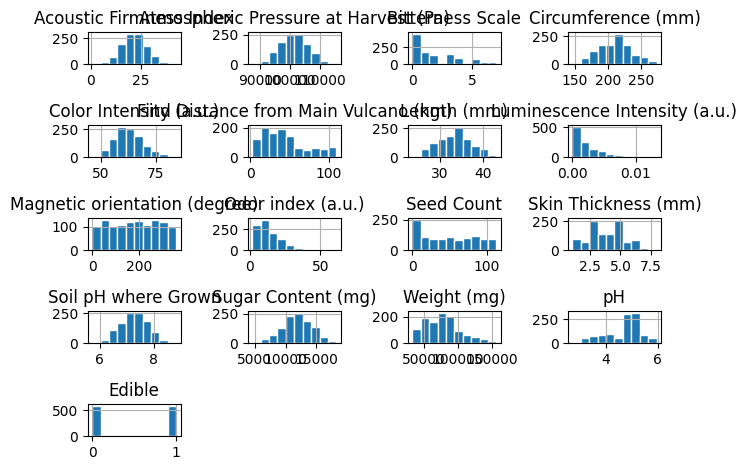

In [12]:
# Histogram after cleaning
cleaned.hist(edgecolor="white") # edgecolor makes it look nicer 
plt.tight_layout()
plt.show()

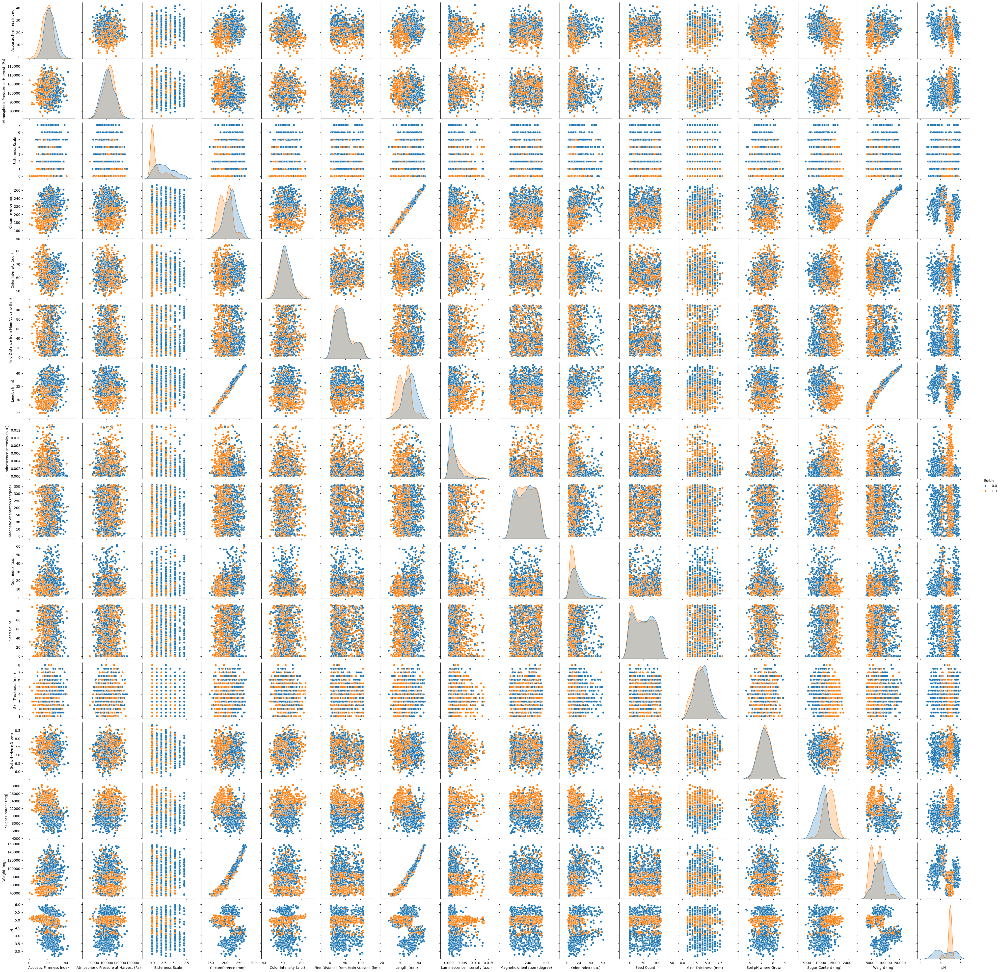

In [13]:
# Pairplot to get an overview of the data after cleaning
sns.pairplot(data=cleaned, hue='Edible')
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

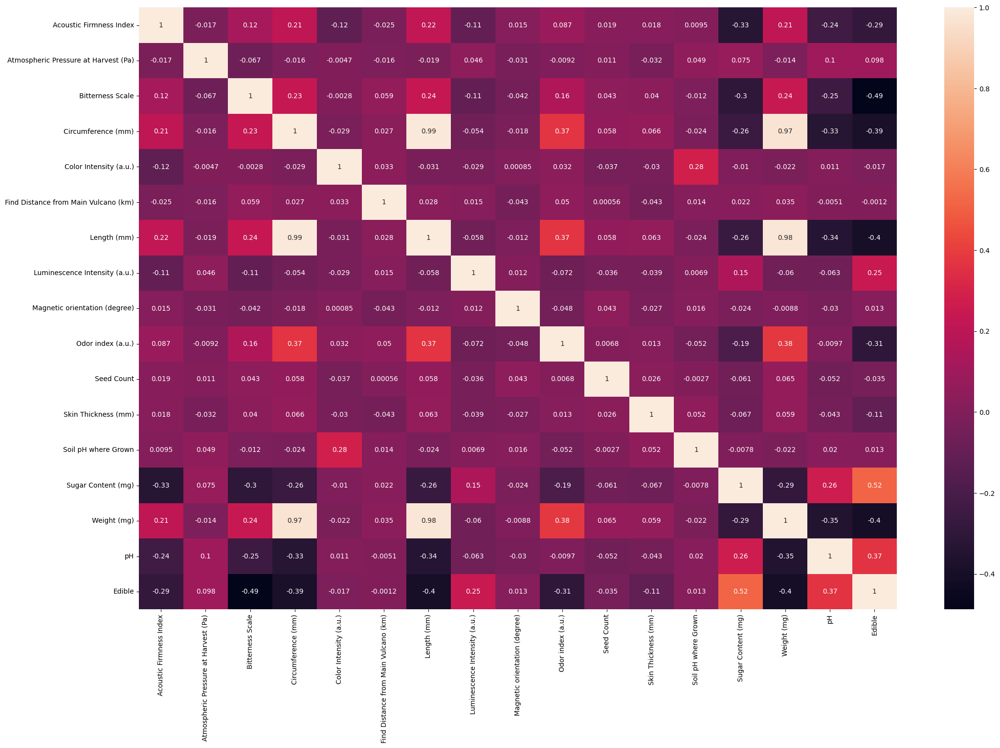

In [14]:
# Correlation matrix after cleaning
corr_matrix = cleaned.corr()
fig_corr, ax_corr = plt.subplots(figsize=(25,16))
sns.heatmap(data=corr_matrix,annot=True, ax=ax_corr)
plt.show

In [15]:
X = cleaned.drop(["Edible"], axis=1) # contains all columns except traget colum Edible 
y = cleaned["Edible"] # only contains the traget colum Edible


,Acoustic Firmness Index,Atmospheric Pressure at Harvest (Pa),Bitterness Scale,Circumference (mm),Color Intensity (a.u.),Find Distance from Main Vulcano (km),Length (mm),Luminescence Intensity (a.u.),Magnetic orientation (degree),Odor index (a.u.),Seed Count,Skin Thickness (mm),Soil pH where Grown,Sugar Content (mg),Weight (mg),pH
0,28.7,98741.0,0.0,222.897985,70.28,103.145212,35.481123,0.002636,61.877407,2.700236,71.355713,2.5,8.14,13792.0,87411.1826,5.090000
2,22.1,109154.0,2.0,234.406576,69.92,37.847317,37.926057,0.000279,61.103057,7.970050,54.442385,1.5,8.03,10008.0,109375.1826,5.219156
4,22.6,103898.0,2.0,180.542626,53.63,63.590438,28.948902,0.008611,317.261190,7.953544,48.057754,5.0,6.71,11475.0,49717.1826,4.800000
5,24.3,106580.0,0.0,179.919563,59.18,24.686984,27.998244,0.001629,92.192794,19.671387,34.594922,3.5,7.83,13257.0,47616.1826,4.780000
6,17.5,108392.0,5.0,183.731597,61.56,64.368942,28.667719,0.001466,252.229976,17.088911,0.805807,3.5,6.79,12537.0,38826.1826,4.800000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1242,17.1,91630.0,4.0,232.216559,58.31,20.549281,37.306247,0.003299,159.307920,2.108987,46.818059,6.0,7.14,8689.0,104461.1826,3.563446
1243,16.8,99423.0,0.0,212.988102,61.08,40.910882,33.728356,0.003155,195.342578,25.475841,7.033815,3.5,6.67,12224.0,77045.1826,5.000000
1245,13.6,93981.0,0.0,181.435023,69.64,48.416290,29.071256,0.000355,118.170049,7.579661,7.756912,2.0,6.99,10423.0,51560.1826,4.880000
1246,26.7,98269.0,1.0,228.399719,76.16,46.333693,37.776037,0.002577,217.742170,14.873524,66.630218,2.0,6.95,6753.0,105907.1826,3.383773


##### Train/Test Split

In [16]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

print("X_train: ",X_train.shape)
print("X_test: ",X_test.shape)
print("y_train: ",y_train.shape)
print("y_test: ",y_test.shape)

X_train:  (688, 16)
X_test:  (459, 16)
y_train:  (688,)
y_test:  (459,)


In [17]:
# Scaling the data
sc = StandardScaler()
sc.fit(X_train)

X_train_sc = sc.transform(X_train)
X_test_sc = sc.transform(X_test)


### Modelling

#### KNN - K-nearest neighbours

In [18]:
# Parameters to opimize the classifier (used scikit-learn.org to find potensially parameters)

n_neighbors = [5, 10, 15, 20, 25] # number of neighbours
weights = ['uniform', 'distance'] # weight function used for predictions
algorithms = ['auto', 'ball_tree', 'kd_tree', 'brute'] # different algorithms used to calculate the nearest neighbours
p_values = [1, 2] # power parameter(1 = Manhatten distance, 2 = Euclidean distance)

best_accuracy = 0
best_params = {} # stores the best parameters


for n_neighbor in n_neighbors:
    for weight in weights:
        for algorithm in algorithms:
            for p_value in p_values:
                knn = KNeighborsClassifier(n_neighbors=n_neighbor, weights=weight, algorithm=algorithm, p=p_value)
                    
                knn.fit(X_train_sc, y_train) # Fit the classifier on the training data
                y_pred = knn.predict(X_test_sc) # Make predictions on the test data
                accuracy = accuracy_score(y_test, y_pred) # Calculate accuracy

                # check if the current model is the best, and update with which parameters that is the best
                if accuracy > best_accuracy:
                    best_accuracy = accuracy
                    best_parameters = {'n_neighbors': n_neighbor, 'weights': weight, 'algorithm': algorithm,'p': p_value}

print("Best Parameters:", best_parameters)
print(f'Accuracy: {accuracy:.4f}')

Best Parameters: {'n_neighbors': 20, 'weights': 'uniform', 'algorithm': 'auto', 'p': 1}
Accuracy: 0.8562


#### Random Forest

In [19]:
# Parameters to opimize the classifier (used scikit-learn.org to find potensially parameters)
criterions = ['entropy', 'gini', 'log_loss'] # functions that measures the quality of the split
values_n_estimator = [100, 250, 500, 750, 1000] # number of trees in the forest

best_accuracy = 0
best_parameters = {} # stores the best parameters

for criterion in criterions:
    for n_estimator in values_n_estimator:
        forest = RandomForestClassifier(criterion=criterion, n_estimators=n_estimator,random_state=42,n_jobs=-1,bootstrap=True)
        
        forest.fit(X_train_sc, y_train) # Fit the classifier on the training data
        y_pred = forest.predict(X_test_sc) # Make predictions on the test data
        accuracy = accuracy_score(y_test, y_pred) # Calculate accuracy
        
        # check if the current model is the best, and update with which parameters that is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_parameters = {'criterion': criterion, 'n_estimators': n_estimator}

print("Best Parameters:", best_parameters)
print(f'Accuracy: {accuracy:.3f}')


Best Parameters: {'criterion': 'gini', 'n_estimators': 750}
Accuracy: 0.887


### Final evaluation

The forest classifier was the best one with an accurancy: 0.887 with the Best Parameters: {'criterion': 'gini', 'n_estimators': 750}

### Kaggle submission

In [20]:
# Using the best parameters from training
forest = RandomForestClassifier(criterion='gini',
                                n_estimators=750,
                                random_state=42,
                                n_jobs=-1,
                               bootstrap=True
                               )
forest.fit(X, y)

# creating a csv file with the results 
submission = forest.predict(test)
df_submission = pd.DataFrame(submission)
df_submission.reset_index(level=0, inplace=True)

df_submission.columns = ['index', 'target']
df_submission.to_csv('submission.csv', index=False)